In [62]:
# importing OpenCV(cv2) module
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pylab as plt
import numpy as np
from skimage import color, exposure, img_as_float, data

In [2]:
img = cv2.imread("./cat_image.jpg")
if img is None:
  print("Failed to load Image")

## About Image

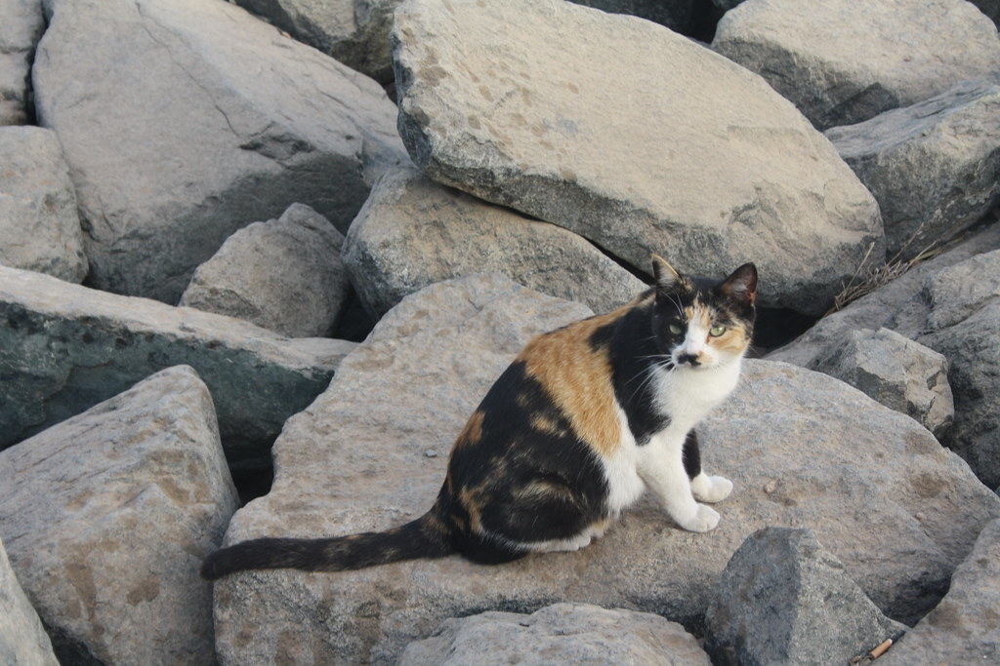

In [3]:
cv2_imshow(img)

In [4]:
print("Pixel Value in bits",img.dtype)
# Check the height of image
print("Image Height",img.shape[0])
# Check the width of image
print("Image Width",img.shape[1])
# Check the number of channels of the image
print("Image Channels",img.shape[2])

Pixel Value in bits uint8
Image Height 683
Image Width 1024
Image Channels 3


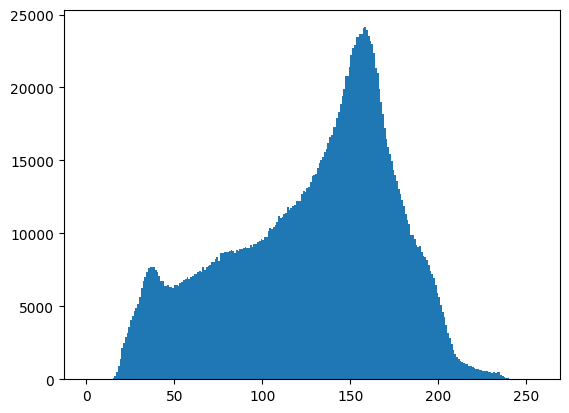

In [5]:
#img.ravel gives an single array of integer from 3 arrays (rgb)
plt.hist(img.ravel(),bins = 256, range = [0,256])
plt.show()

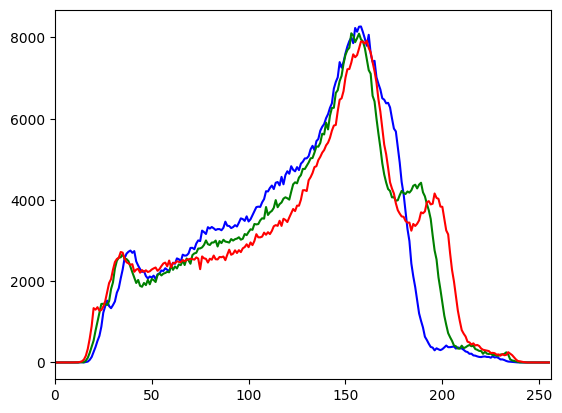

In [6]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

# Transformations

## GreyScale Transformation

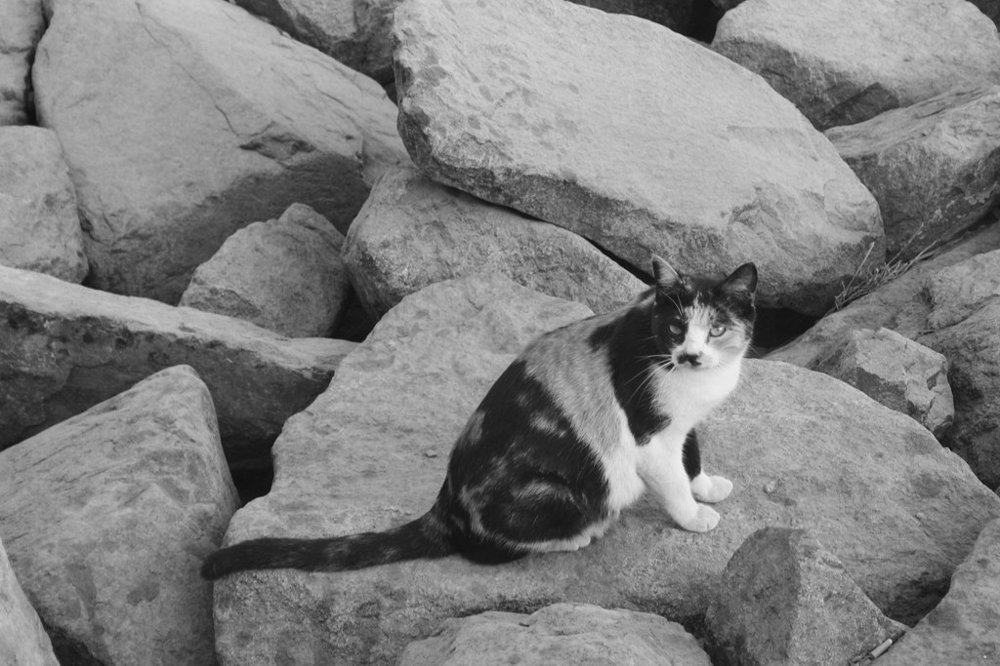

In [7]:
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(gray_img)

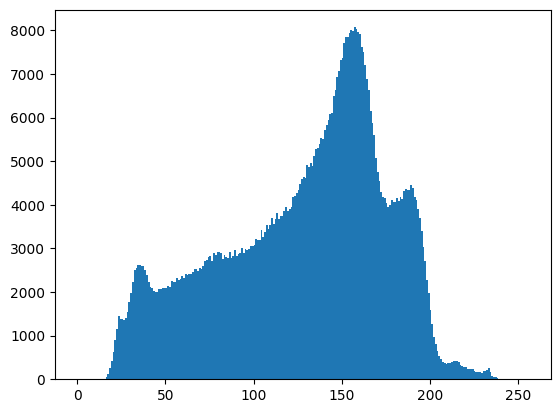

In [8]:
plt.hist(gray_img.ravel(),bins = 256, range = [0, 256])
plt.show()

In [9]:
gray_img.shape

(683, 1024)

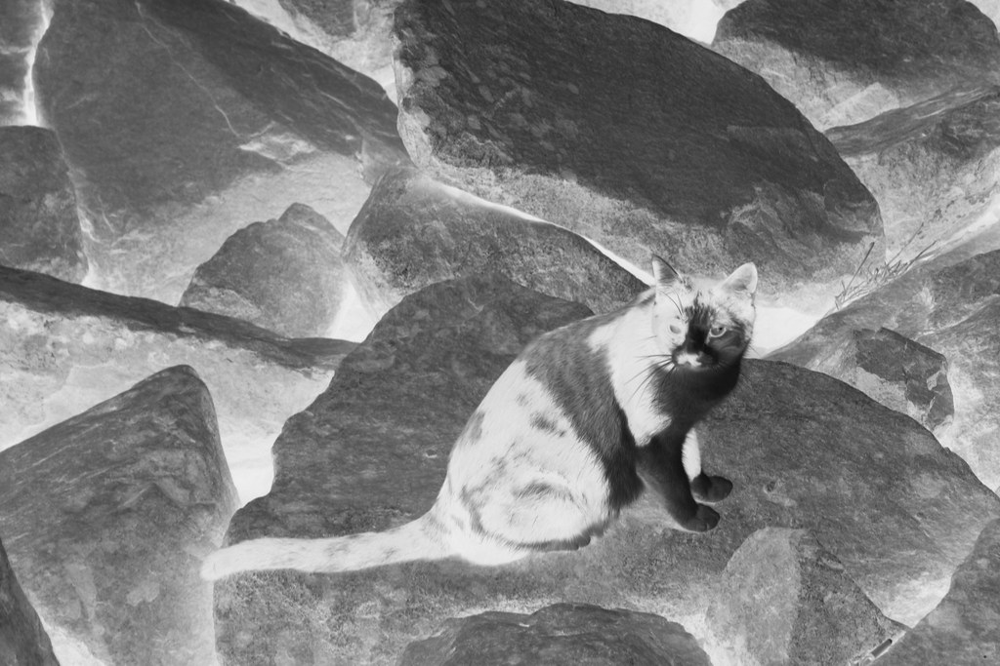

In [10]:
im2 = 255 - gray_img
cv2_imshow(im2)

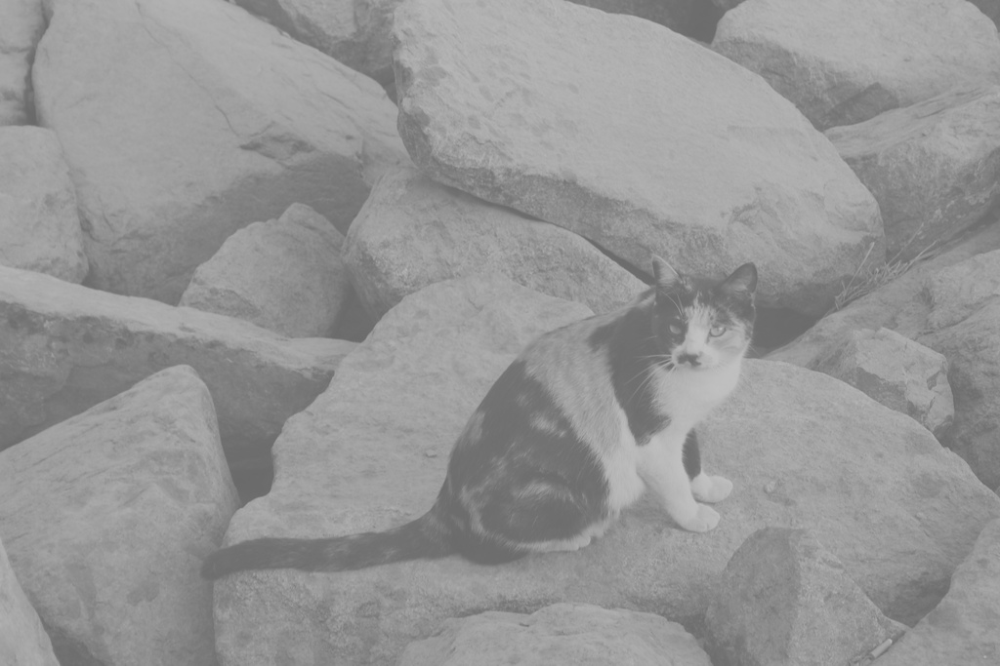

In [11]:
im3 = (100.0/255)*gray_img + 100
cv2_imshow(im3)

## Contour Transformation
#  **TODO 3**

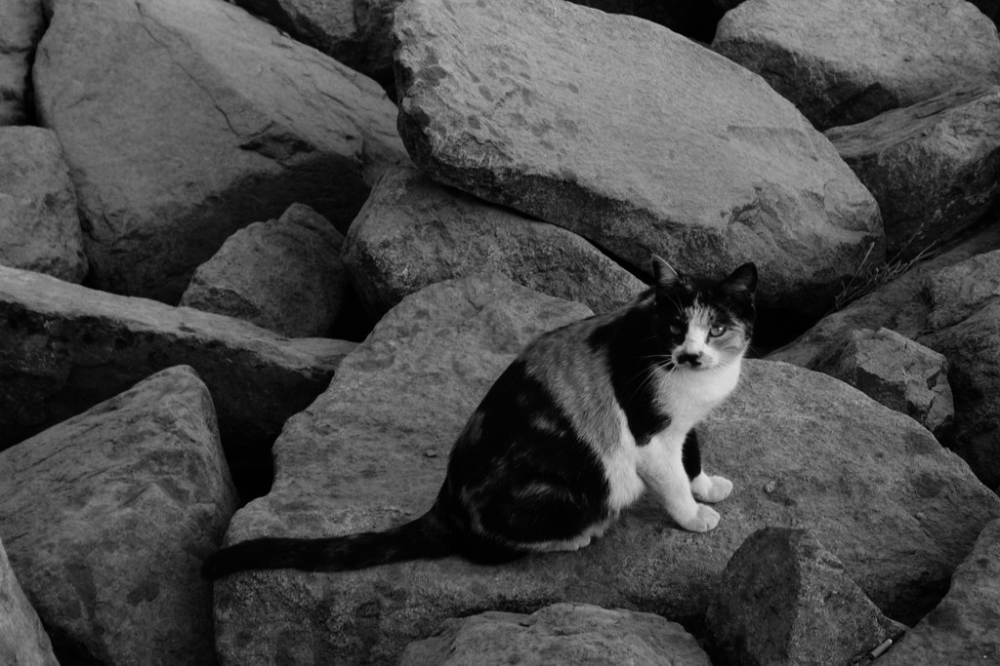

In [12]:
im4 = 255.0*(gray_img/255.0)**2
cv2_imshow(im4)

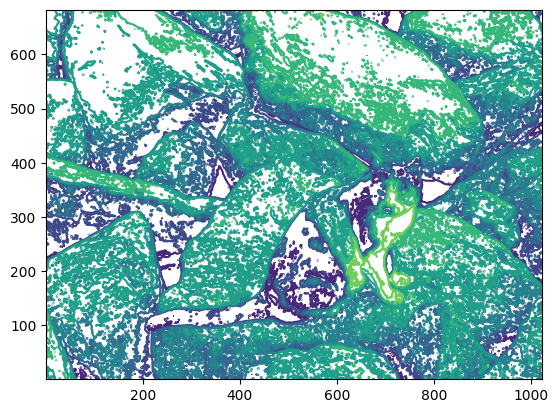

In [13]:
plt.contour(gray_img, origin = "image")

In [14]:
# plt.contour(img, origin = "image")

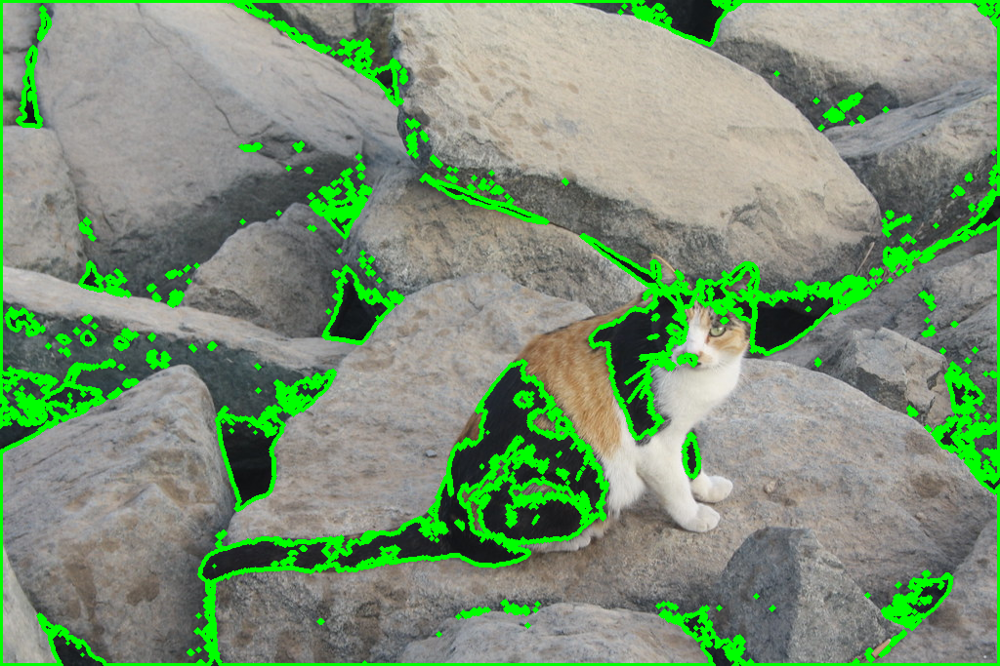

In [15]:
ret, thresh = cv2.threshold(gray_img,50,255,0)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(img, contours, -1, (0, 255, 0), 3)
cv2_imshow(img)

## Histogram Equalization

##  **TODO 5**

In [16]:
def histeq(im, nbr_bins = 256):
  """ Histogram equalization of a grayscale image. """
  # get the image histogram
  imhist, bins = np.histogram(im.flatten(), nbr_bins, [0, 256])
  cdf = imhist.cumsum() # cumulative distribution function
  cdf = imhist.max()*cdf/cdf.max()  #normalize
  cdf_mask = np.ma.masked_equal(cdf, 0)
  cdf_mask = (cdf_mask - cdf_mask.min())*255/(cdf_mask.max()-cdf_mask.min())
  cdf = np.ma.filled(cdf_mask,0).astype('uint8')
  return cdf[im.astype('uint8')]

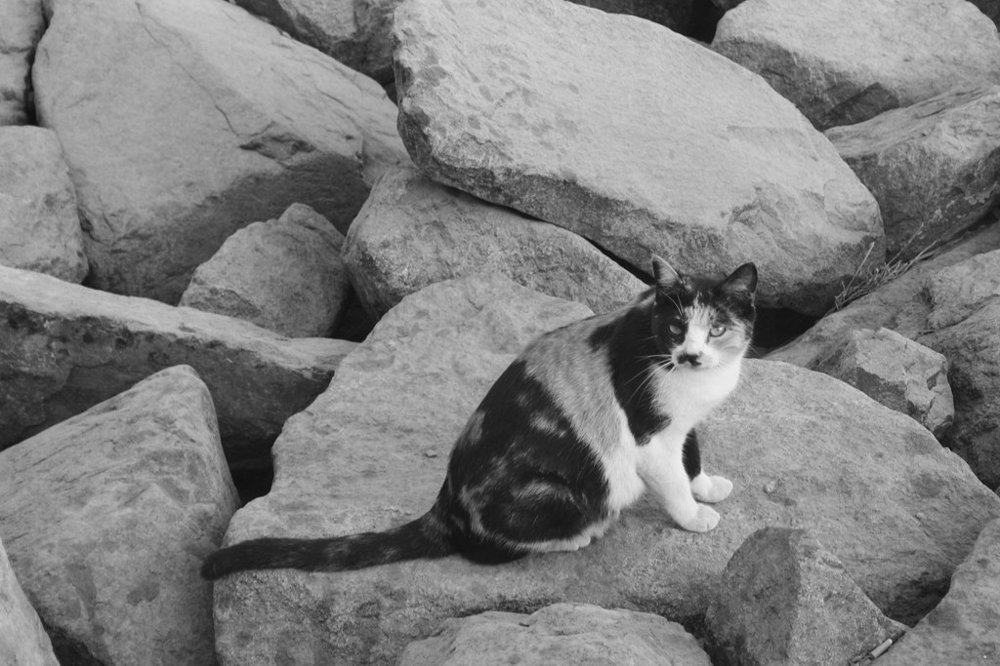

In [20]:
cv2_imshow(gray_img)

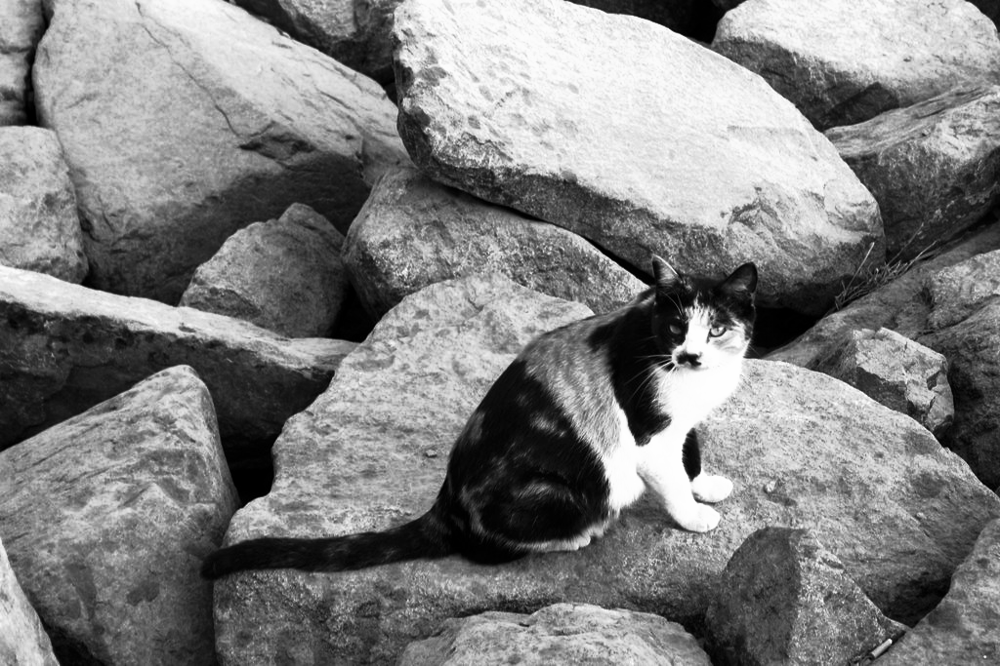

In [19]:
im5 = histeq(gray_img)
cv2_imshow(im5)

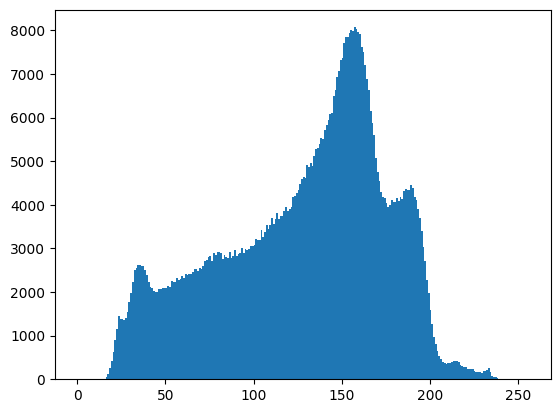

In [21]:
# Before histogram equalization
plt.hist(gray_img.ravel(),bins = 256, range = [0, 256])
plt.show()

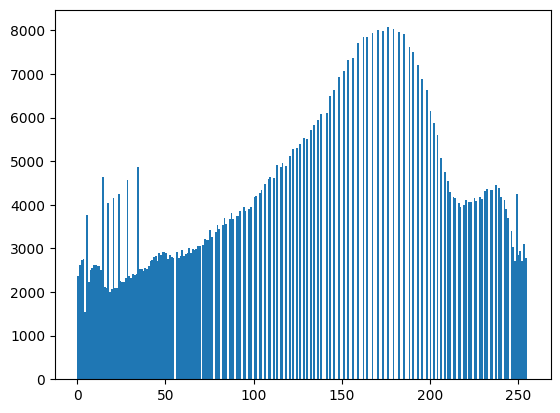

In [22]:
plt.hist(im5.ravel(),bins = 256, range = [0, 256])
plt.show()

## Fourier Transformation

### Magnitude Spectrum

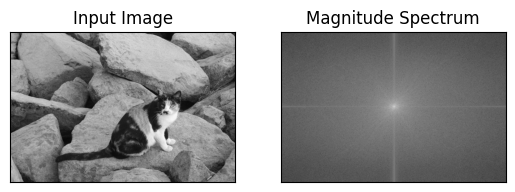

In [31]:
f = np.fft.fft2(gray_img)
# Bring the zero-frequency component to the center
fshift = np.fft.fftshift(f)
magnitude_spectrum = 20*np.log(np.abs(fshift))

plt.subplot(121),plt.imshow(gray_img, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

### HighPass Filter


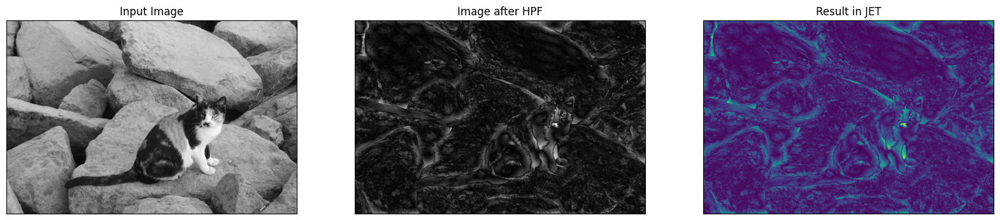

In [32]:
rows, cols = gray_img.shape
crow,ccol = round(rows/2) , round(cols/2)
# remove low frequencies with a rectangle size of 10
fshift[crow-10:crow+10, ccol-10:ccol+10] = 0
f_ishift = np.fft.ifftshift(fshift)
img_back = np.fft.ifft2(f_ishift)
img_back = np.abs(img_back)

plt.figure(figsize=([20, 20]))
plt.subplot(131),plt.imshow(gray_img, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(img_back, cmap = 'gray')
plt.title('Image after HPF'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(img_back)
plt.title('Result in JET'), plt.xticks([]), plt.yticks([])
plt.show()

### Interpolation

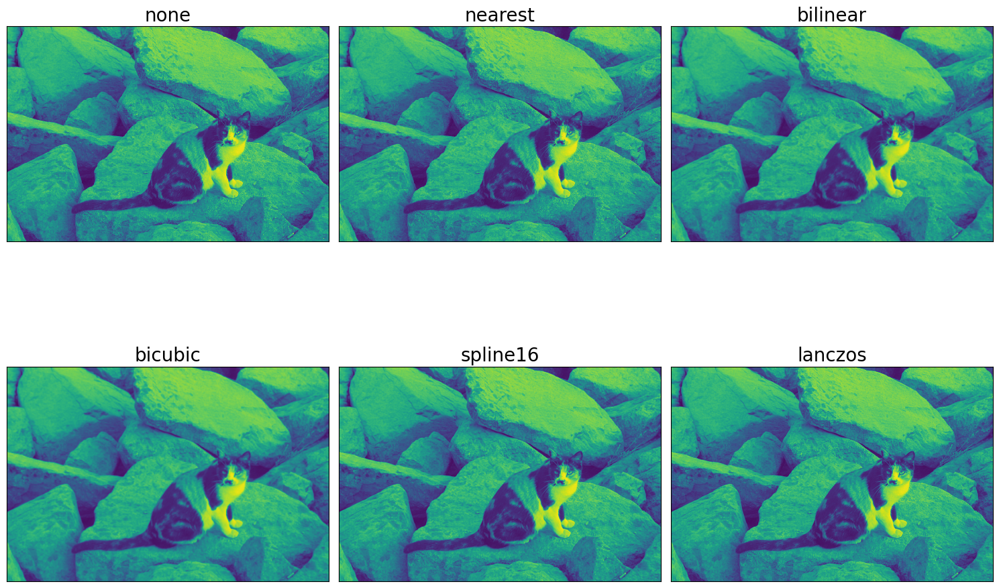

In [33]:
im = gray_img
methods = ['none', 'nearest', 'bilinear', 'bicubic', 'spline16', 'lanczos']
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 12), subplot_kw={'xticks': [], 'yticks': []})
fig.subplots_adjust(hspace=0.05, wspace=0.05)
for ax, interp_method in zip(axes.flat, methods):
    ax.imshow(im, interpolation=interp_method)
    ax.set_title(str(interp_method), size=20)
plt.tight_layout()
plt.show()

## Mode Transformation

<Figure size 640x480 with 0 Axes>

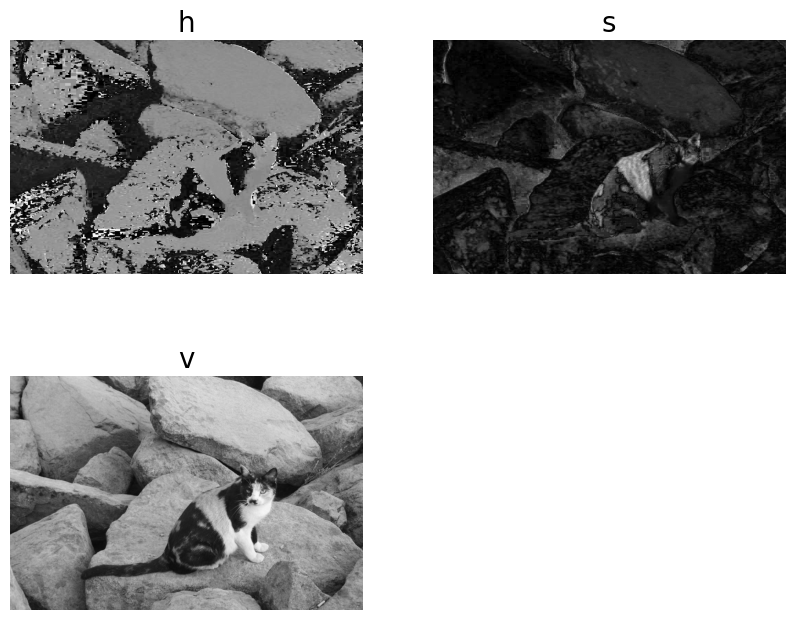

In [36]:
im = cv2.imread('cat_image.jpg')
im_hsv = color.rgb2hsv(im)
plt.gray()
plt.figure(figsize=(10,8))
plt.subplot(221), plt.imshow(im_hsv[...,0]), plt.title('h', size=20),
plt.axis('off')
plt.subplot(222), plt.imshow(im_hsv[...,1]), plt.title('s', size=20),
plt.axis('off')
plt.subplot(223), plt.imshow(im_hsv[...,2]), plt.title('v', size=20),
plt.axis('off')
plt.subplot(224), plt.axis('off')
plt.show()

## Crop

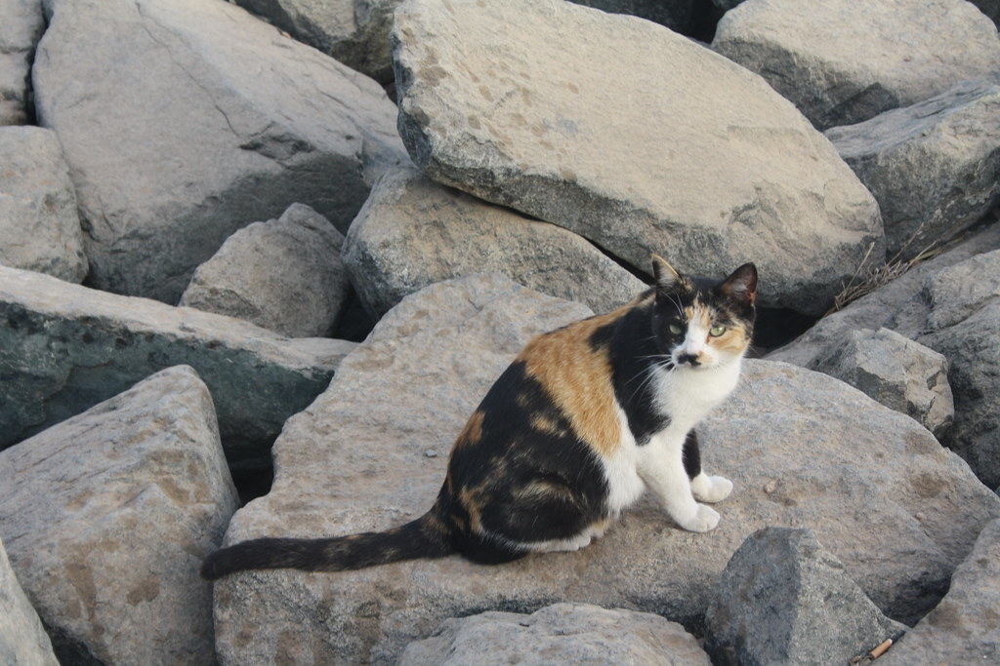

In [40]:
img = cv2.imread("cat_image.jpg")
cv2_imshow(img)

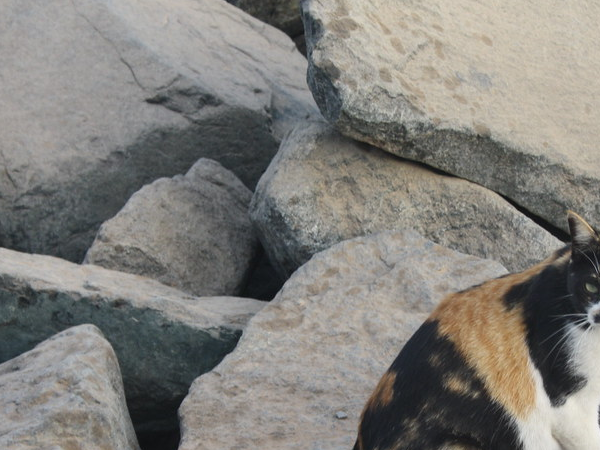

In [41]:
crop = img[50:500, 100:700]
cv2_imshow(crop)

## Resize

In [42]:
img_resize = cv2.resize(img, (1050, 1610))
print(img.shape, img_resize.shape)
cv2_imshow(img_resize)

Output hidden; open in https://colab.research.google.com to view.

## Affine Transformation

### Rotation

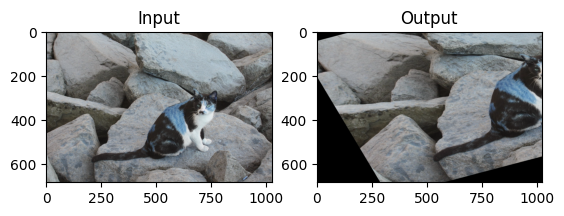

In [43]:
img = cv2.imread('cat_image.jpg')

rows, cols, ch = img.shape

pts1 = np.float32([[50, 50],
                   [200, 50],
                   [50, 200]])

pts2 = np.float32([[10, 100],
                   [200, 50],
                   [100, 250]])

M = cv2.getAffineTransform(pts1, pts2)
dst = cv2.warpAffine(img, M, (cols, rows))

plt.subplot(121)
plt.imshow(img)
plt.title('Input')

plt.subplot(122)
plt.imshow(dst)
plt.title('Output')

plt.show()

## Image Arithmetic Operation

# **TODO 4**


In [46]:
from PIL import Image
from PIL.ImageChops import add, subtract, multiply, difference, screen


### Multiply

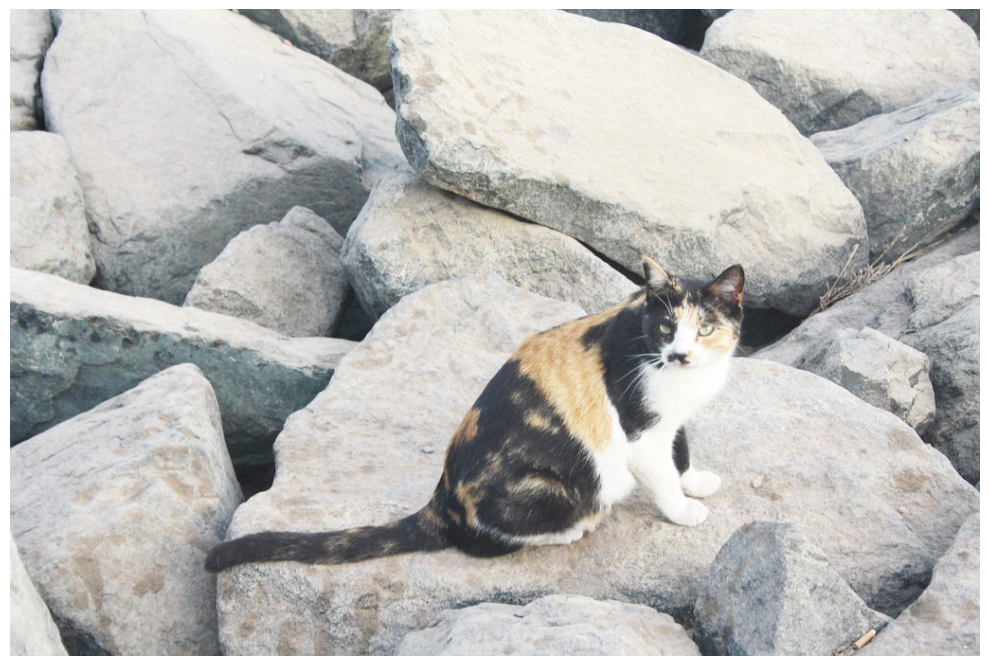

In [94]:
#superimpossing
img = Image.open("cat_image.jpg")

im2 = Image.open("cat_image.jpg").convert('RGB').resize((img.width, img.height))

plt.figure(figsize=(10,10))
plt.imshow(screen(img, im2))
plt.axis('off') # no axis ticks
plt.tight_layout()
plt.show()

### Add

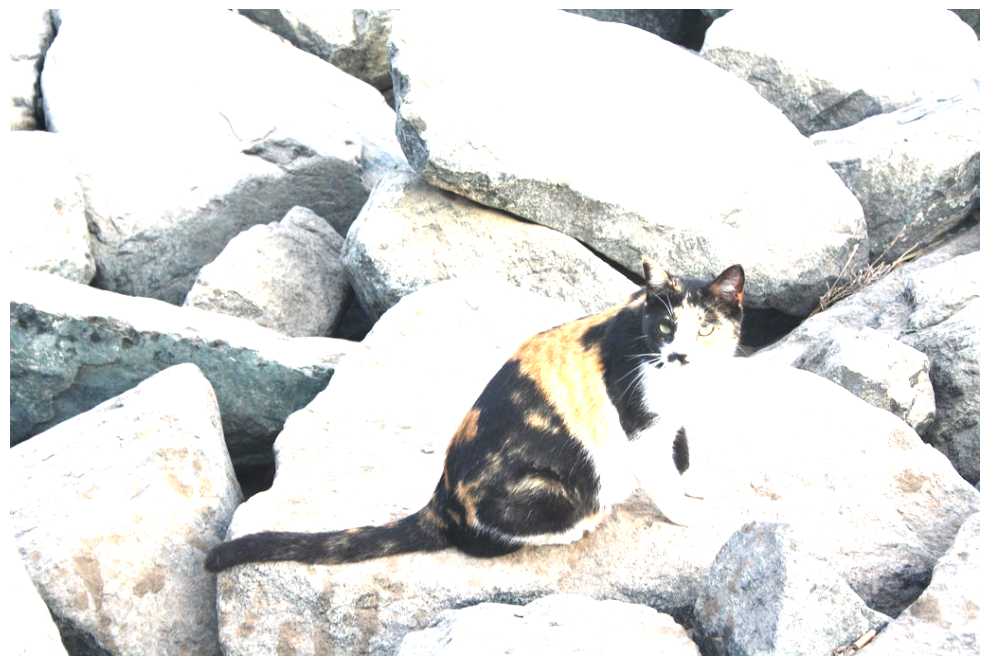

In [48]:
plt.figure(figsize=(10,10))
plt.imshow(add(img, im2))
plt.axis('off') # no axis ticks
plt.tight_layout()
plt.show()

## Swirl **Transformation**

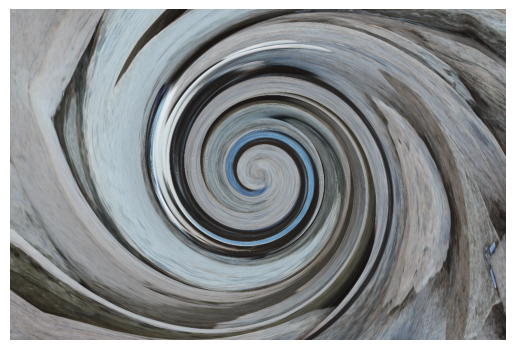

In [49]:
from skimage.transform import swirl
im = cv2.imread("cat_image.jpg")
swirled = swirl(im, rotation=0, strength=15, radius=1000)
plt.imshow(swirled)
plt.axis('off')
plt.show()

## Sampling

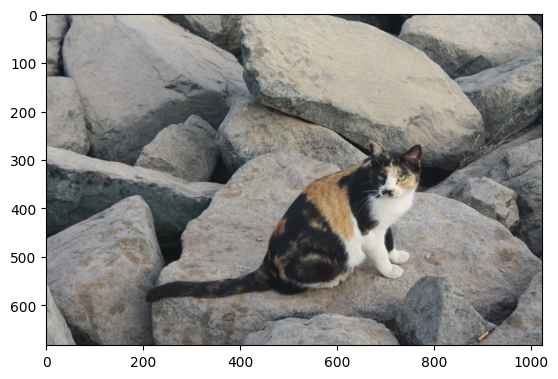

In [59]:
im = Image.open("cat_image.jpg") # the original small clock image
plt.imshow(im)
plt.show()

### Nearest Neighbour Upsampling

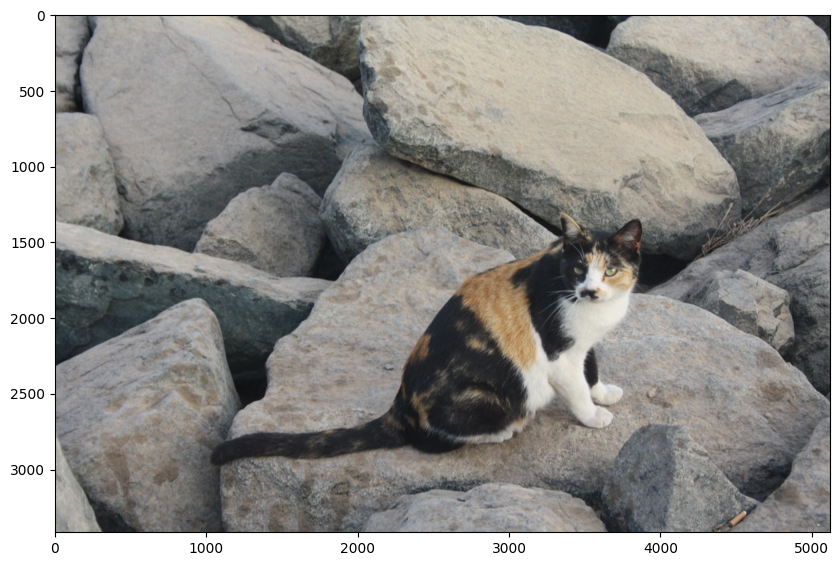

In [51]:
im1 = im.resize((im.width*5, im.height*5), Image.NEAREST) # nearest neighbor interpolation
plt.figure(figsize=(10,10))
plt.imshow(im1)
plt.show()

### Bilinear Upsampling

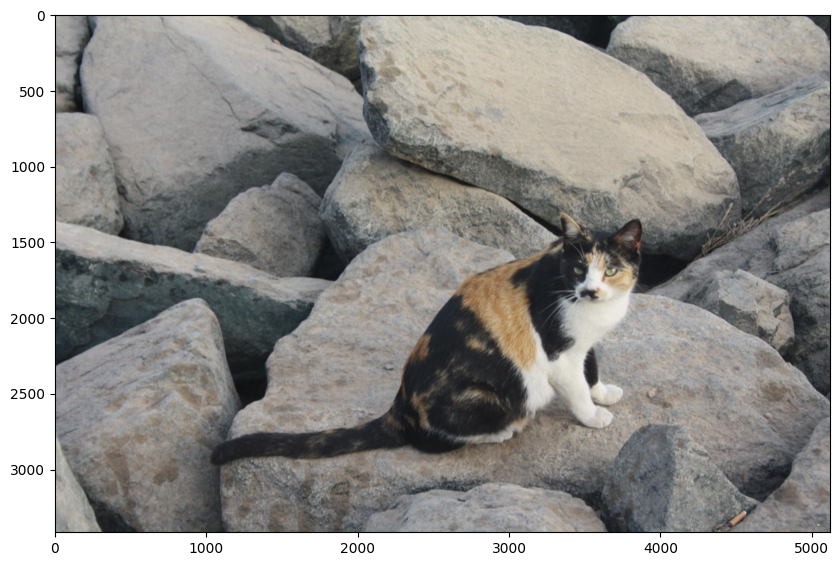

In [53]:
im1 = im.resize((im.width*5, im.height*5), Image.BILINEAR) # up-sample with bi-linear interpolation
plt.figure(figsize=(10,10))
plt.imshow(im1)
plt.show()

### Downsampling

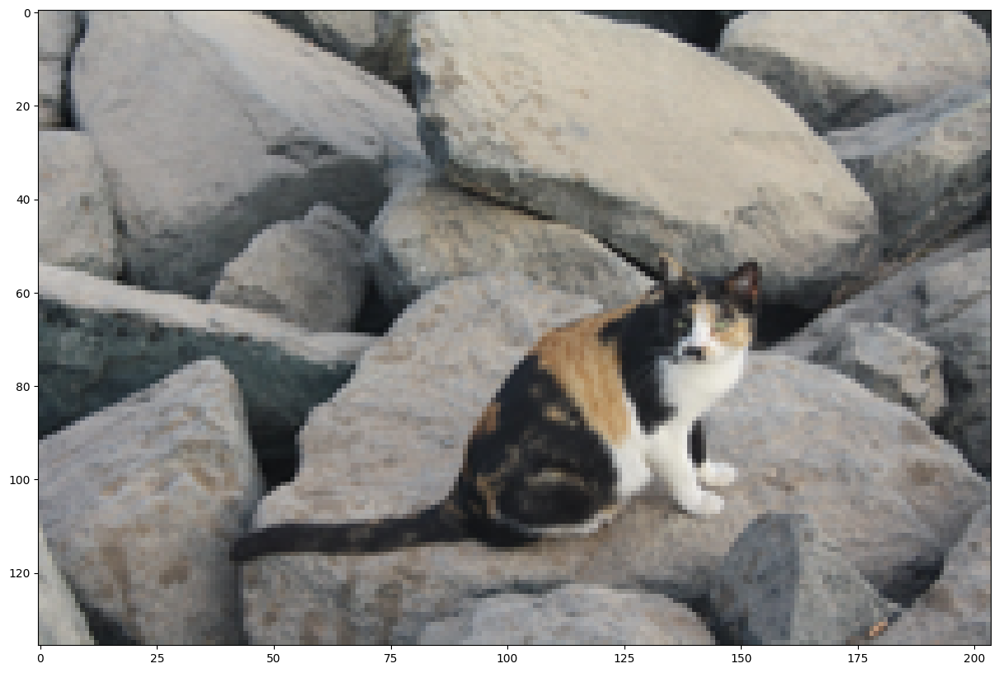

In [60]:
im2 = im.resize((im.width//5, im.height//5))
plt.figure(figsize=(15,10))
plt.imshow(im2)
plt.show()

## Gaussian Blur

In [64]:
from scipy import ndimage, misc, signal
from scipy.signal.windows import gaussian
import numpy.fft
import scipy.fftpack as fp

### Frequency Domain Filter

## TODO

<ipython-input-65-5e190bdd2f7d>:15: ComplexWarning: Casting complex values to real discards the imaginary part
  plt.subplot(2,3,4), plt.imshow( (20*np.log10( 0.1 + fp.fftshift(freq))).astype(int))
<ipython-input-65-5e190bdd2f7d>:18: ComplexWarning: Casting complex values to real discards the imaginary part
  fp.fftshift(freq_kernel))).astype(int))
<ipython-input-65-5e190bdd2f7d>:20: ComplexWarning: Casting complex values to real discards the imaginary part
  plt.imshow( (20*np.log10( 0.1 + fp.fftshift(convolved))).astype(int))


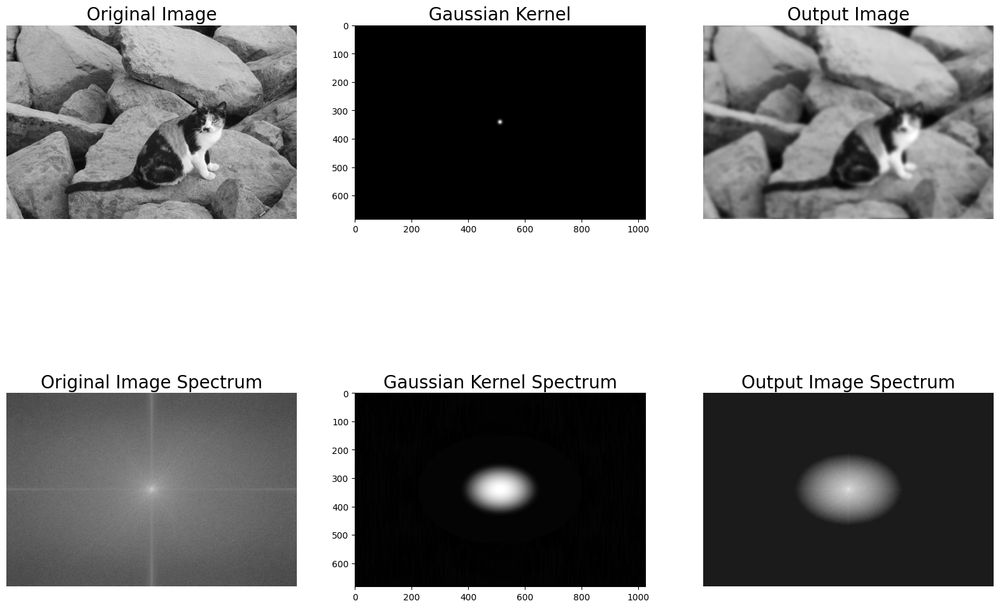

In [65]:
plt.figure(figsize=(20,15))
plt.gray() # show the filtered result in grayscale
im = np.mean(cv2.imread('cat_image.jpg'), axis=2)
gauss_kernel = np.outer(gaussian(im.shape[0], 5),gaussian(im.shape[1], 5))
freq = fp.fft2(im)
assert(freq.shape == gauss_kernel.shape)
freq_kernel = fp.fft2(fp.ifftshift(gauss_kernel))
convolved = freq*freq_kernel # by the convolution theorem, simply multiply in the frequency domain
im1 = fp.ifft2(convolved).real
plt.subplot(2,3,1), plt.imshow(im), plt.title('Original Image',
size=20), plt.axis('off')
plt.subplot(2,3,2), plt.imshow(gauss_kernel), plt.title('Gaussian Kernel', size=20)
plt.subplot(2,3,3), plt.imshow(im1) # the imaginary part is an artifact
plt.title('Output Image', size=20), plt.axis('off')
plt.subplot(2,3,4), plt.imshow( (20*np.log10( 0.1 + fp.fftshift(freq))).astype(int))
plt.title('Original Image Spectrum', size=20), plt.axis('off')
plt.subplot(2,3,5), plt.imshow( (20*np.log10( 0.1 +
fp.fftshift(freq_kernel))).astype(int))
plt.title('Gaussian Kernel Spectrum', size=20), plt.subplot(2,3,6)
plt.imshow( (20*np.log10( 0.1 + fp.fftshift(convolved))).astype(int))
plt.title('Output Image Spectrum', size=20), plt.axis('off')
plt.subplots_adjust(wspace=0.2, hspace=0)
plt.show()

## High Pass Tranformation

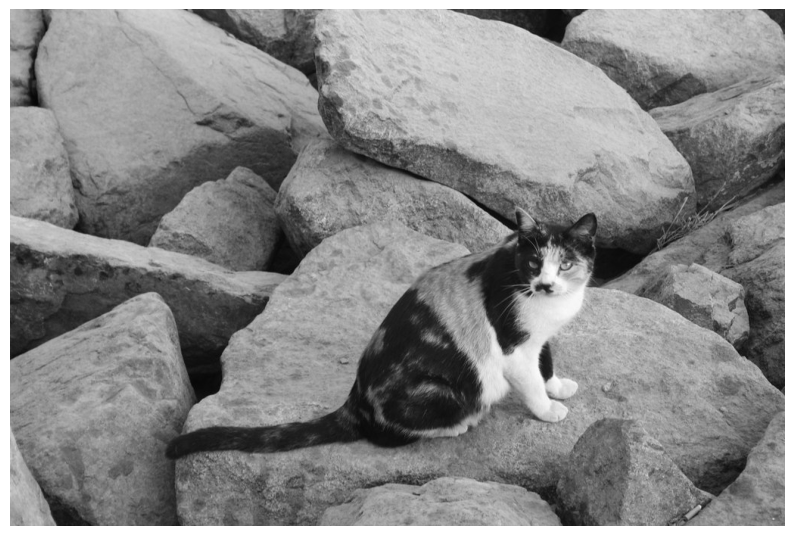

In [67]:
#High-Pass Filter (HPF)
im = np.array(Image.open('cat_image.jpg').convert('L'))
plt.figure(figsize=(10,10))
plt.imshow(im, cmap=plt.cm.gray)
plt.axis('off')
plt.show()

## Low Pass Tranformation

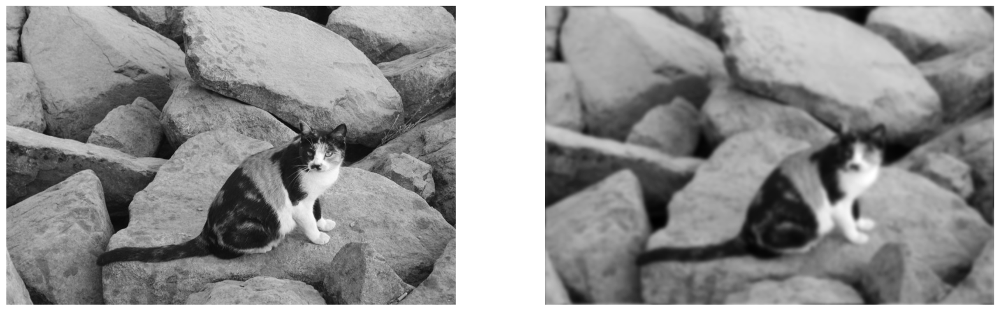

In [69]:
##Low-pass filter
fig, (axes1, axes2) = plt.subplots(1, 2, figsize=(20,10))
plt.gray() # show the result in grayscale
im = np.mean(cv2.imread('cat_image.jpg'), axis=2)
freq = fp.fft2(im)
freq_gaussian = ndimage.fourier_gaussian(freq, sigma=4)
im1 = fp.ifft2(freq_gaussian)
axes1.imshow(im)
axes1.axis('off')
axes2.imshow(im1.real) # the imaginary part is an artifact
axes2.axis('off')
plt.show()

## Band Pass Transformation
##  **TODO 6**

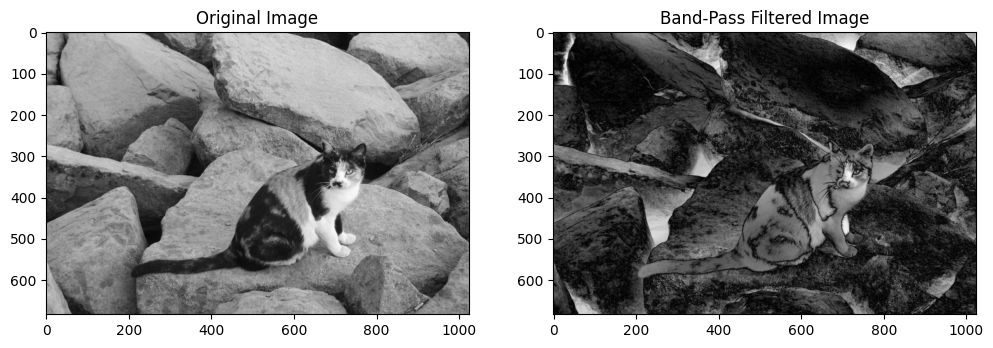

In [92]:
image = gray_img

dft = cv2.dft(np.float32(image), flags=cv2.DFT_COMPLEX_OUTPUT)
dft_shift = np.fft.fftshift(dft)

rows, cols = image.shape
crow, ccol = rows // 2 , cols // 2  # center of the image

r_out = 500 # Outer radius (high-pass)
r_in = 3  # Inner radius (low-pass)

mask = np.zeros((rows, cols, 2), np.uint8)
cv2.circle(mask, (ccol, crow), r_out, (1, 1, 1), thickness=-1)
cv2.circle(mask, (ccol, crow), r_in, (0, 0, 0), thickness=-1)

fshift = dft_shift * mask

f_ishift = np.fft.ifftshift(fshift)
img_back = cv2.idft(f_ishift)
img_back = cv2.magnitude(img_back[:,:,0], img_back[:,:,1])

img_back = cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX)
img_back = np.uint8(img_back)

plt.figure(figsize=(12, 6))
plt.subplot(121), plt.imshow(image, cmap='gray'), plt.title('Original Image')
plt.subplot(122), plt.imshow(img_back, cmap='gray'), plt.title('Band-Pass Filtered Image')
plt.show()

## Erosion Tranformation

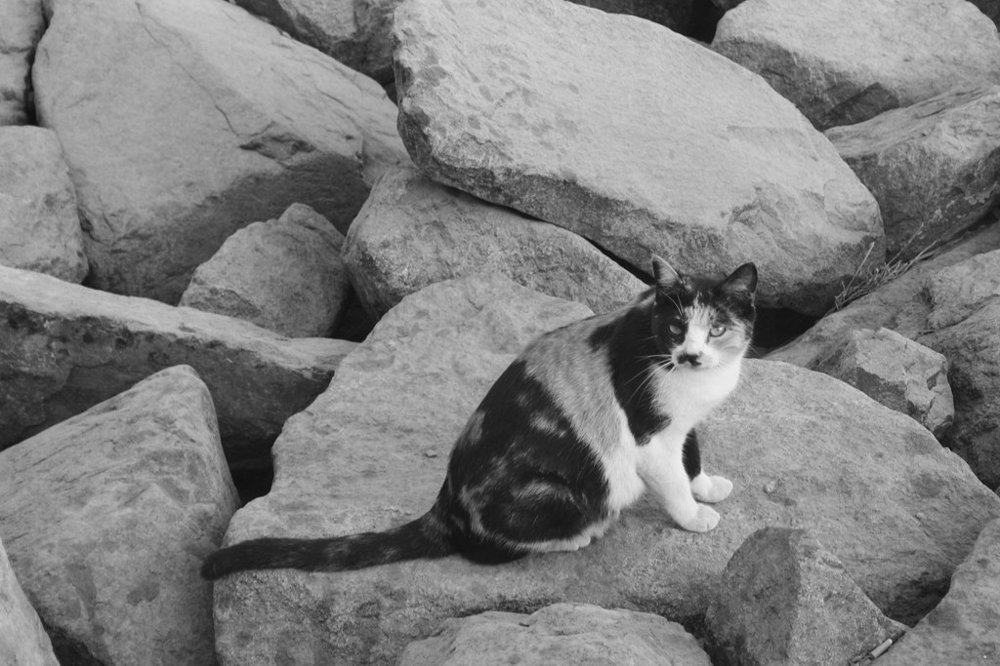

In [73]:
img = cv2.imread('cat_image.jpg', 0)
cv2_imshow(img)
kernel = np.ones((5, 5), np.uint8)

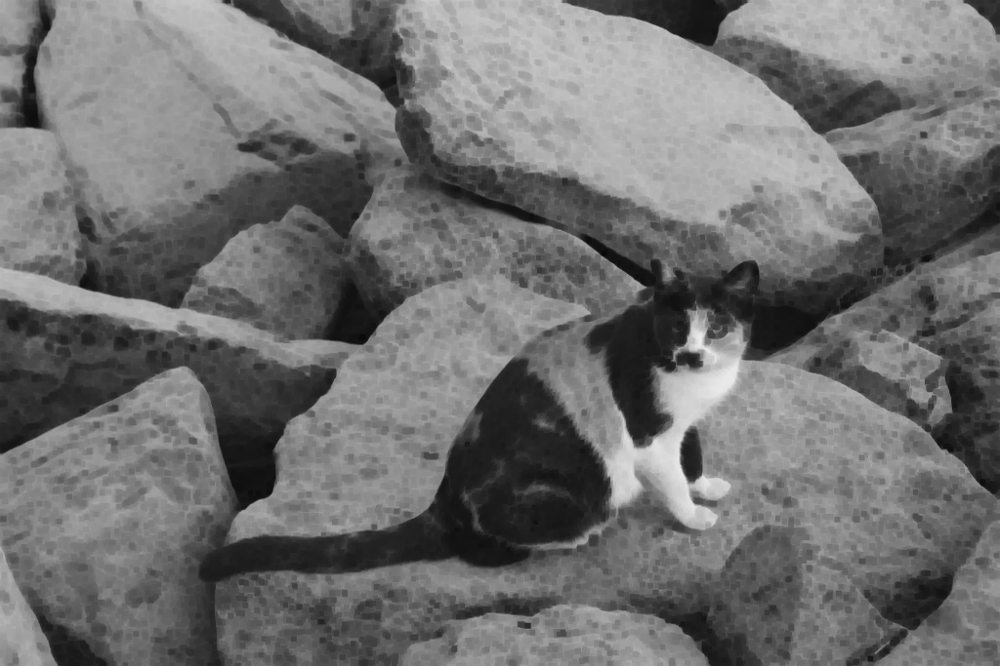

In [74]:
img_erosion = cv2.erode(img, kernel, iterations=1)
cv2_imshow(img_erosion)


## Dilation

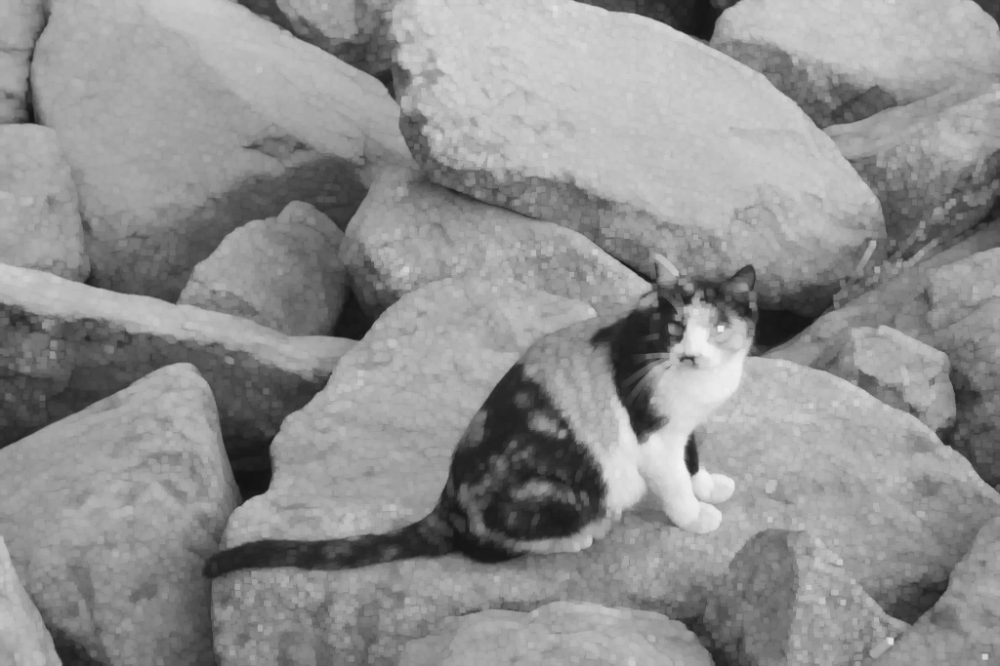

In [75]:
img_dilation = cv2.dilate(img, kernel, iterations=1)
cv2_imshow(img_dilation)

## Opening Transformation
## **TODO 7**

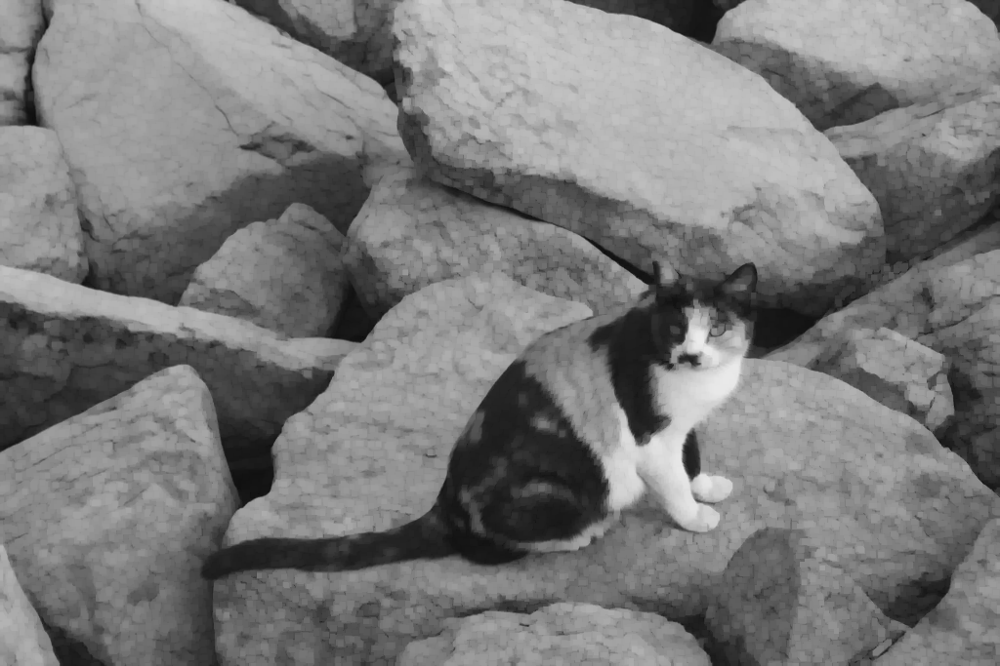

In [76]:
img_erosion = cv2.erode(img, kernel, iterations=1)
img_dilation = cv2.dilate(img_erosion, kernel, iterations=1)
cv2_imshow(img_dilation)

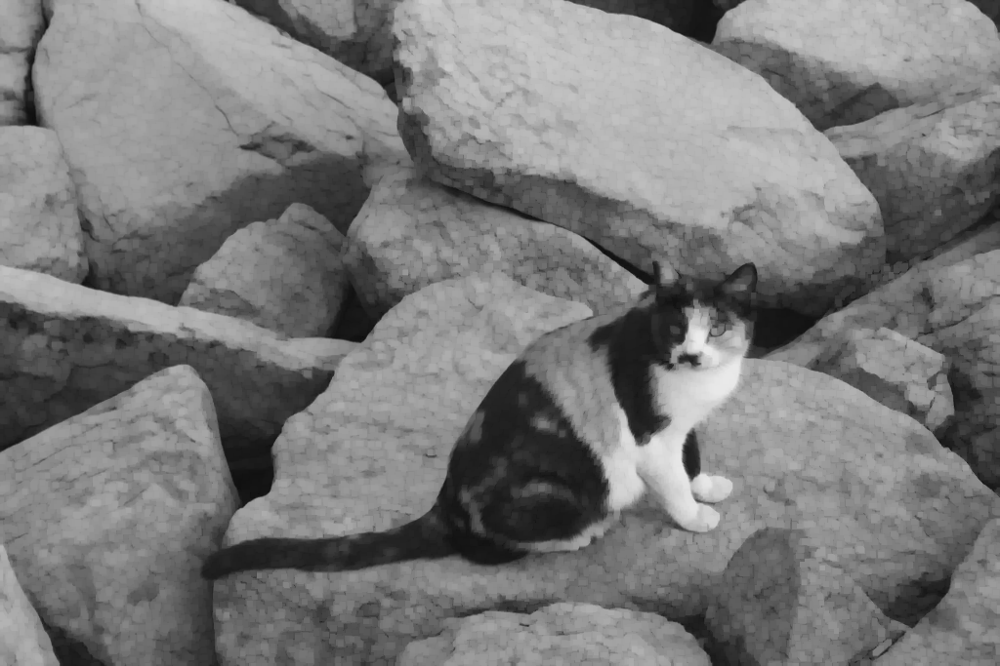

In [78]:
#Method 2
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=1)
cv2_imshow(opening)

## Closing Transformation
## **TODO 7**

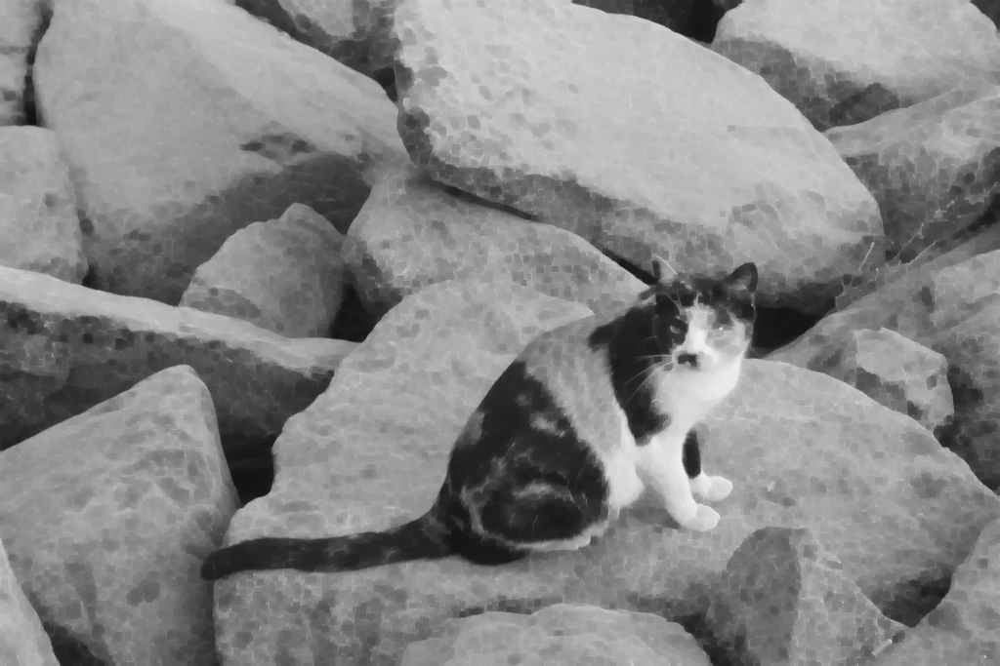

In [77]:
img_dilation = cv2.dilate(img, kernel, iterations=1)
img_erosion = cv2.erode(img_dilation, kernel, iterations=1)
cv2_imshow(img_erosion)

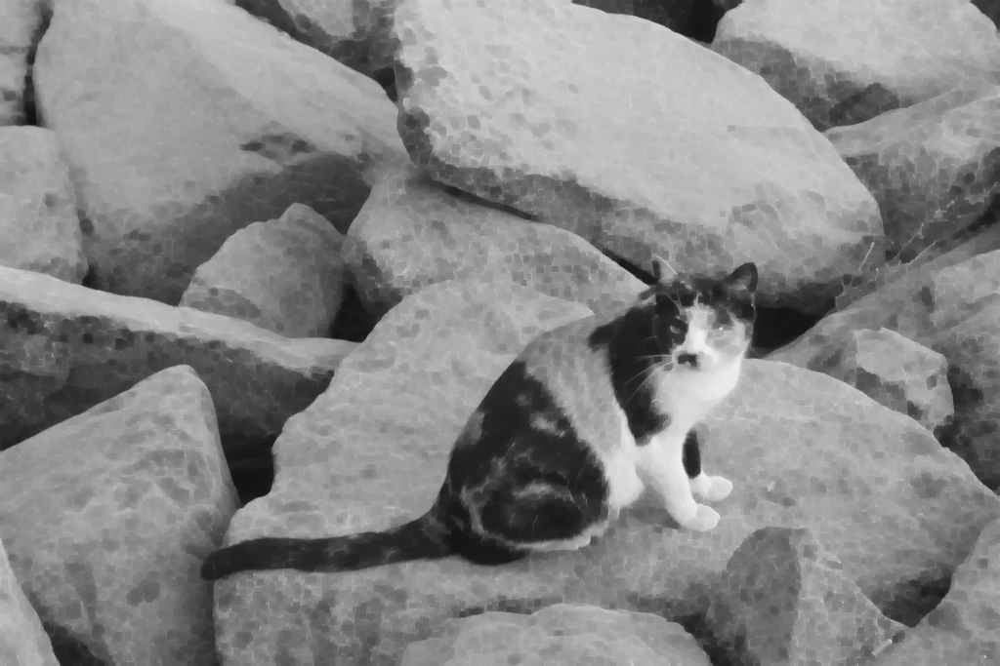

In [79]:
#Method 2
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel, iterations=1)
cv2_imshow(closing)